# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on the Celeb A dataset which is a large set of celebrity face images.

In [1]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder

import numpy as np
import matplotlib.pyplot as plt
from gan.utils import show_images

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [2]:
from gan.train import train

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "gpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [4]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [5]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). You can use simply use relu as well.

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [6]:
from gan.models import Discriminator, Generator

# Data loading: Celeb A Dataset

The CelebA images we provide have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.

In [7]:
batch_size = 512
scale_size = 64  # We resize the images to 64x64 for training

celeba_root = 'celeba_data'

In [8]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

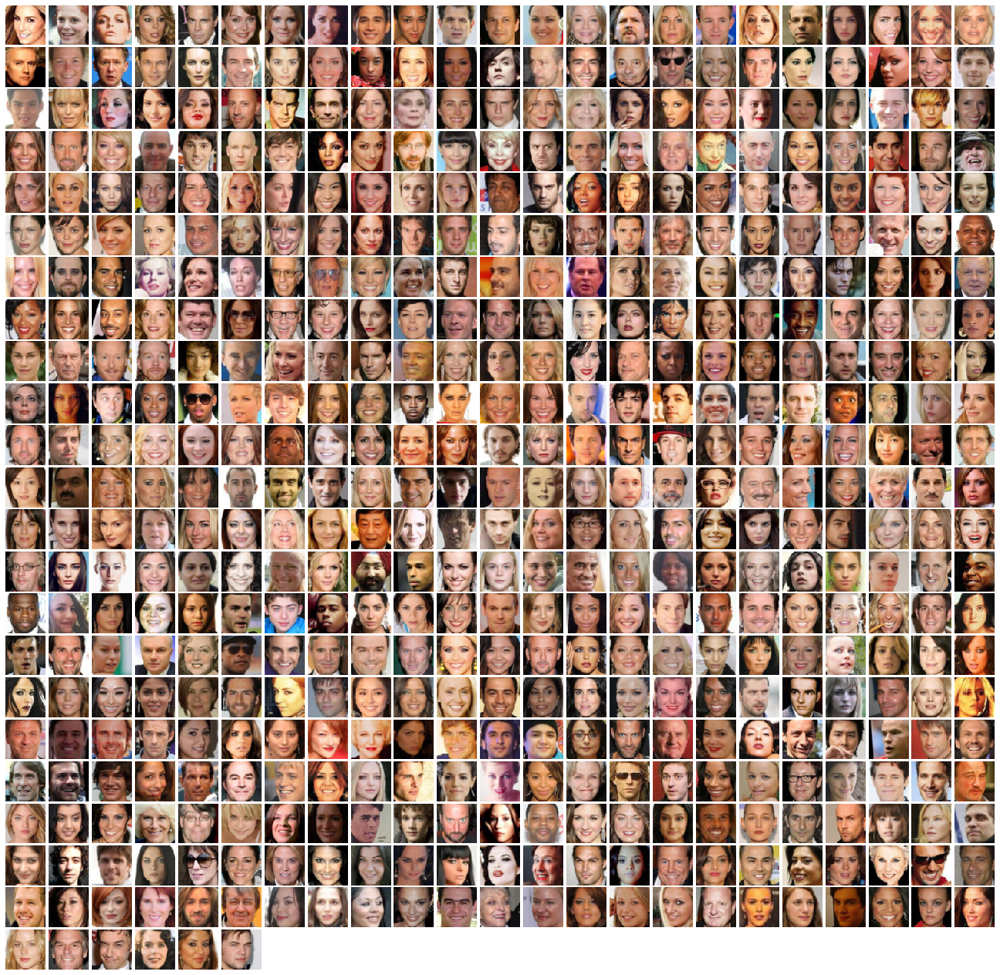

In [9]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [10]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.0002

### Train GAN

In [11]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [12]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.024, G:0.9352


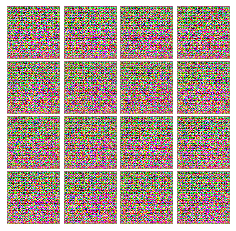


Iter: 150, D: 0.3608, G:1.84


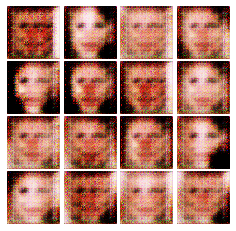


EPOCH:  2
Iter: 300, D: 0.659, G:1.217


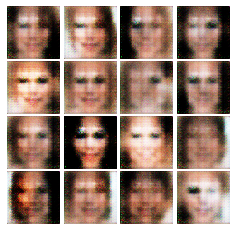


Iter: 450, D: 0.4877, G:1.511


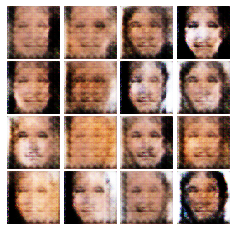


EPOCH:  3
Iter: 600, D: 0.5064, G:2.085


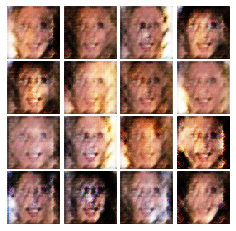


EPOCH:  4
Iter: 750, D: 0.5403, G:0.6815


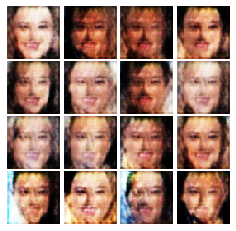


Iter: 900, D: 0.3447, G:1.121


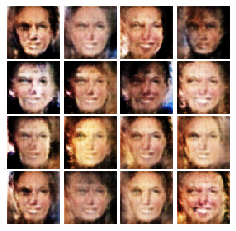


EPOCH:  5
Iter: 1050, D: 0.2858, G:1.47


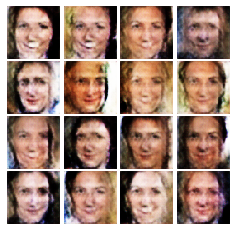


Iter: 1200, D: 0.2433, G:2.038


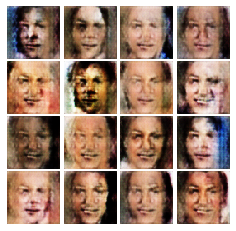


EPOCH:  6
Iter: 1350, D: 0.2249, G:1.396


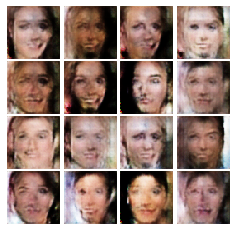


EPOCH:  7
Iter: 1500, D: 0.1196, G:1.891


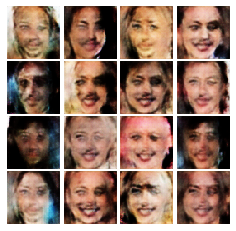


Iter: 1650, D: 1.305, G:0.8589


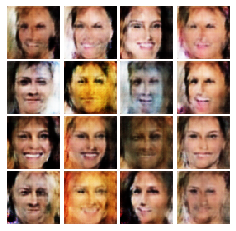


EPOCH:  8
Iter: 1800, D: 0.2615, G:1.507


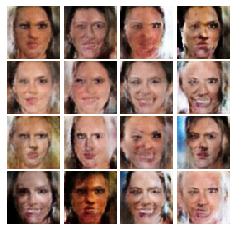


Iter: 1950, D: 0.2371, G:2.379


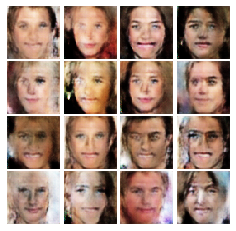


EPOCH:  9
Iter: 2100, D: 0.1125, G:2.615


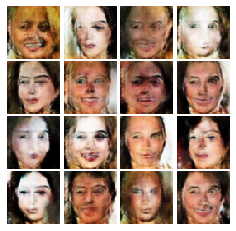


EPOCH:  10
Iter: 2250, D: 0.451, G:1.222


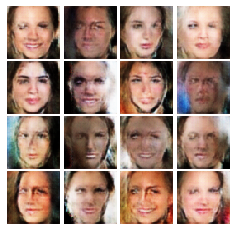


Iter: 2400, D: 0.2491, G:2.311


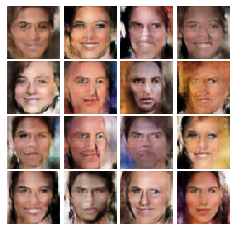


EPOCH:  11
Iter: 2550, D: 0.2443, G:1.505


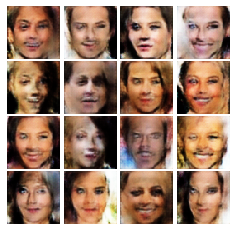


Iter: 2700, D: 0.2525, G:2.935


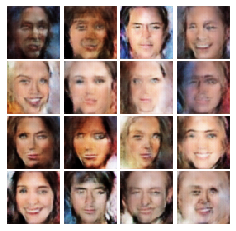


EPOCH:  12
Iter: 2850, D: 0.1652, G:2.934


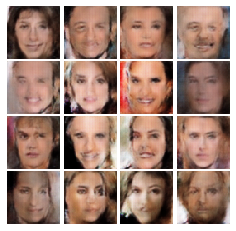


EPOCH:  13
Iter: 3000, D: 0.6566, G:2.096


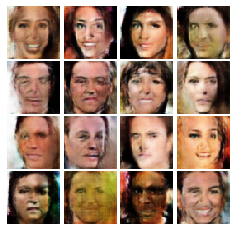


Iter: 3150, D: 0.1206, G:3.749


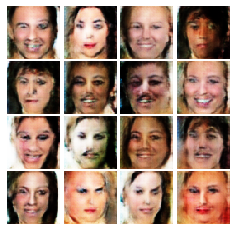


EPOCH:  14
Iter: 3300, D: 0.033, G:1.605


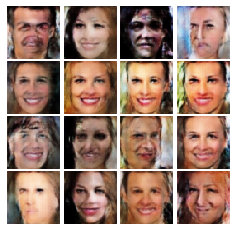


EPOCH:  15
Iter: 3450, D: 0.383, G:1.071


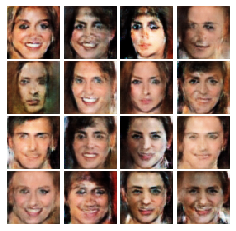


Iter: 3600, D: 2.606, G:3.458


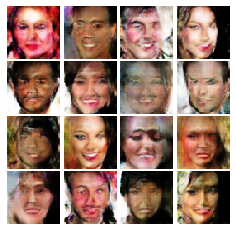


EPOCH:  16
Iter: 3750, D: 0.09416, G:2.783


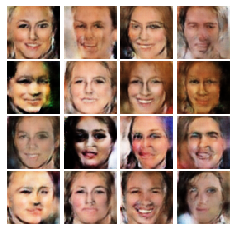


Iter: 3900, D: 0.2307, G:1.879


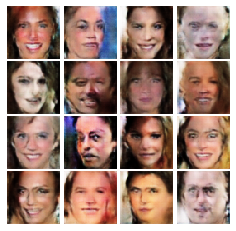


EPOCH:  17
Iter: 4050, D: 0.1857, G:5.132


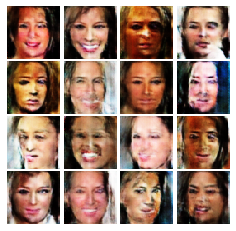


EPOCH:  18
Iter: 4200, D: 0.0167, G:3.828


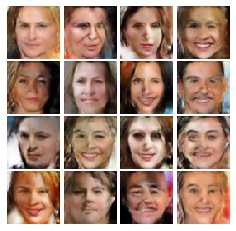


Iter: 4350, D: 0.3636, G:3.39


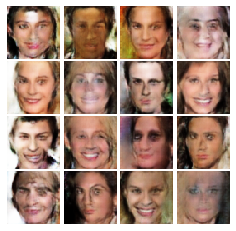


EPOCH:  19
Iter: 4500, D: 1.087, G:0.3136


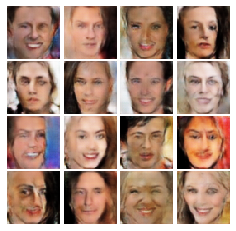


Iter: 4650, D: 0.09392, G:3.019


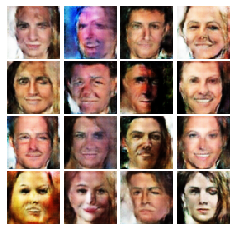


EPOCH:  20
Iter: 4800, D: 0.04753, G:3.109


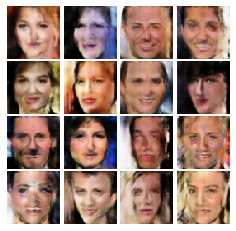


EPOCH:  21
Iter: 4950, D: 0.199, G:4.446


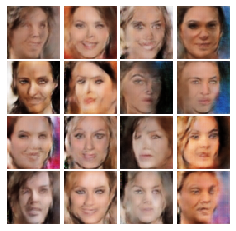


Iter: 5100, D: 0.02145, G:2.897


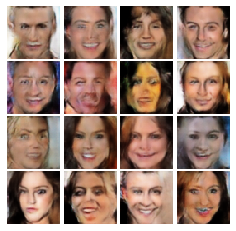


EPOCH:  22
Iter: 5250, D: 0.7607, G:2.127


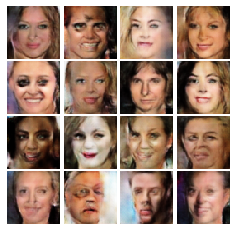


Iter: 5400, D: 0.5737, G:4.478


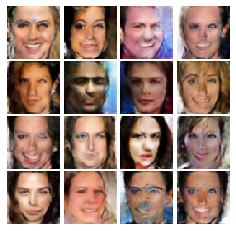


EPOCH:  23
Iter: 5550, D: 0.2862, G:2.405


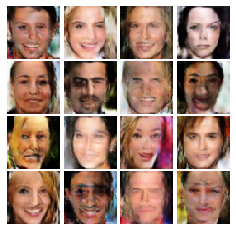


EPOCH:  24
Iter: 5700, D: 0.3608, G:2.151


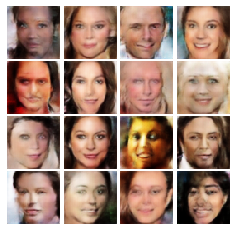


Iter: 5850, D: 0.1481, G:2.97


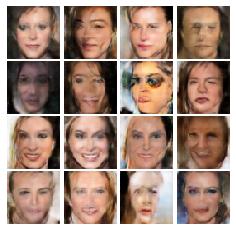


EPOCH:  25
Iter: 6000, D: 0.7223, G:1.521


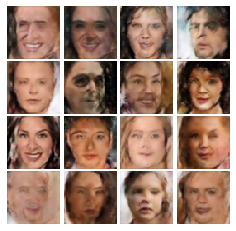


EPOCH:  26
Iter: 6150, D: 1.021, G:7.008


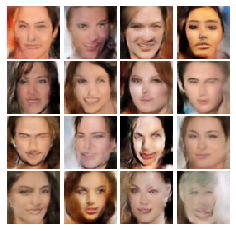


Iter: 6300, D: 0.1517, G:2.047


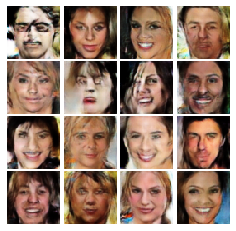


EPOCH:  27
Iter: 6450, D: 0.6143, G:1.494


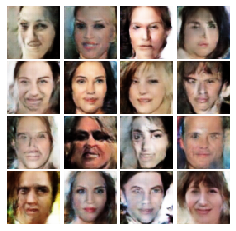


Iter: 6600, D: 0.3037, G:2.838


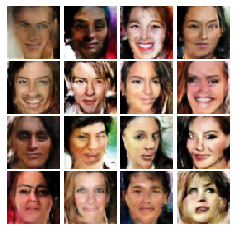


EPOCH:  28
Iter: 6750, D: 0.1169, G:1.305


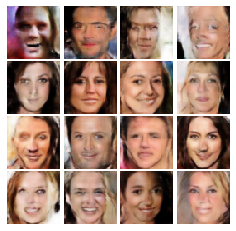


EPOCH:  29
Iter: 6900, D: 0.04391, G:4.533


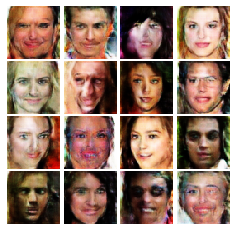


Iter: 7050, D: 0.5081, G:2.338


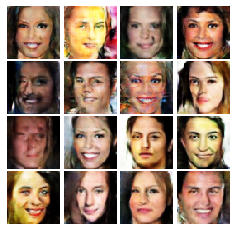


EPOCH:  30
Iter: 7200, D: 0.403, G:1.872


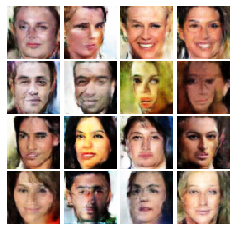


Iter: 7350, D: 0.7469, G:6.128


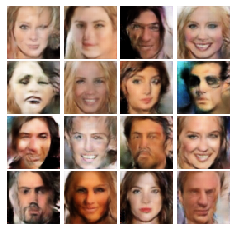


EPOCH:  31
Iter: 7500, D: 0.03322, G:0.7471


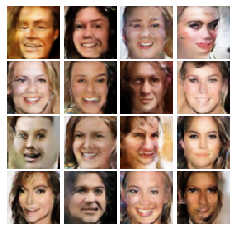


EPOCH:  32
Iter: 7650, D: 0.1235, G:2.773


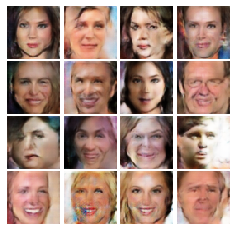


Iter: 7800, D: 0.3648, G:2.72


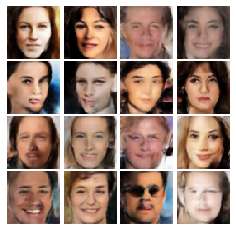


EPOCH:  33
Iter: 7950, D: 0.03111, G:4.857


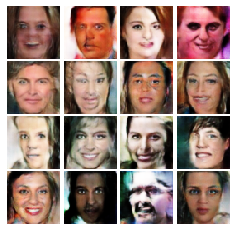


Iter: 8100, D: 0.1316, G:4.348


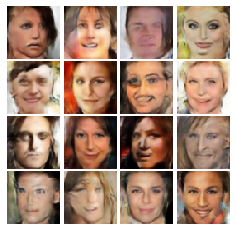


EPOCH:  34
Iter: 8250, D: 0.1856, G:3.804


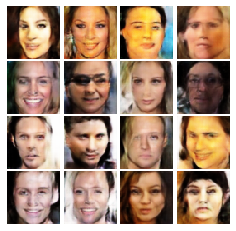


EPOCH:  35
Iter: 8400, D: 0.1151, G:3.955


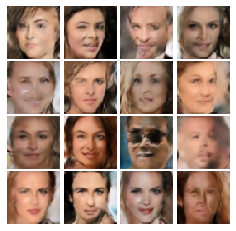


Iter: 8550, D: 0.3112, G:3.624


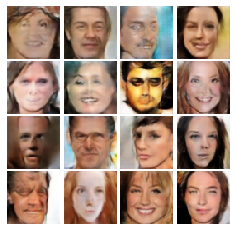


EPOCH:  36
Iter: 8700, D: 0.06574, G:3.501


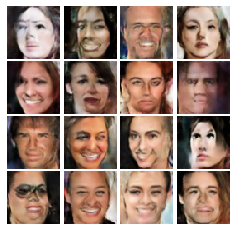


Iter: 8850, D: 0.7183, G:5.225


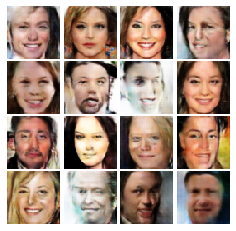


EPOCH:  37
Iter: 9000, D: 0.07719, G:3.384


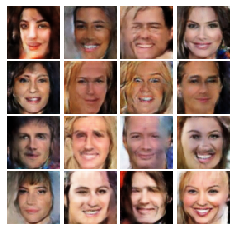


EPOCH:  38
Iter: 9150, D: 0.2363, G:1.836


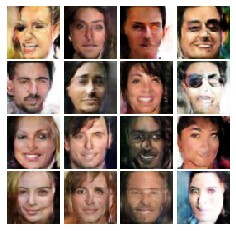


Iter: 9300, D: 0.1184, G:2.623


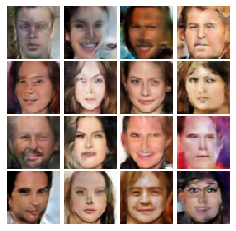


EPOCH:  39
Iter: 9450, D: 0.04328, G:1.979


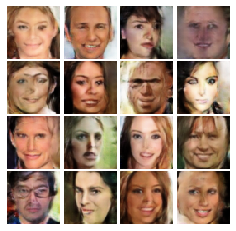


EPOCH:  40
Iter: 9600, D: 0.1378, G:3.585


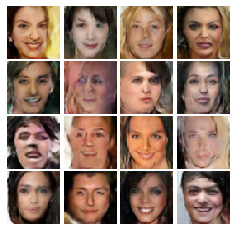


Iter: 9750, D: 0.06801, G:4.026


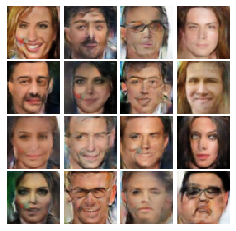


EPOCH:  41
Iter: 9900, D: 0.1135, G:4.35


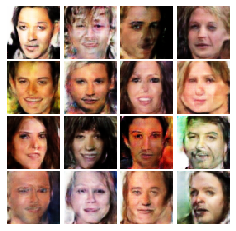


Iter: 10050, D: 0.1291, G:3.674


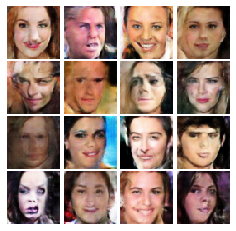


EPOCH:  42
Iter: 10200, D: 0.2027, G:2.606


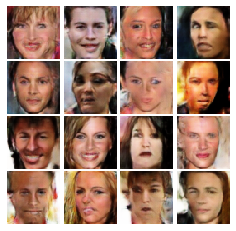


EPOCH:  43
Iter: 10350, D: 0.2621, G:2.905


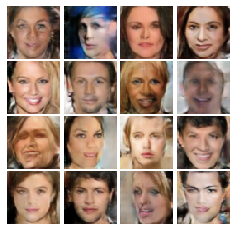


Iter: 10500, D: 0.1156, G:2.358


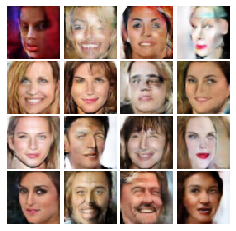


EPOCH:  44
Iter: 10650, D: 0.04062, G:3.274


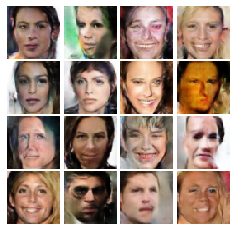


Iter: 10800, D: 0.1889, G:3.055


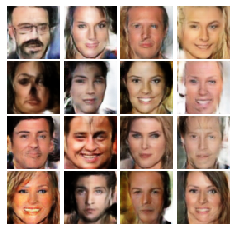


EPOCH:  45
Iter: 10950, D: 0.1451, G:5.401


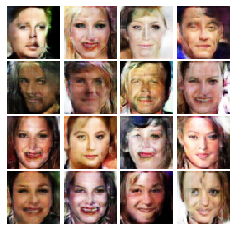


EPOCH:  46
Iter: 11100, D: 0.1974, G:4.601


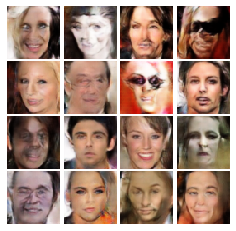


Iter: 11250, D: 0.02549, G:2.612


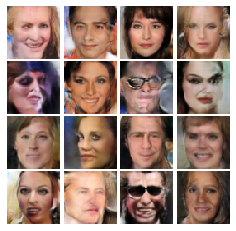


EPOCH:  47
Iter: 11400, D: 0.5931, G:2.191


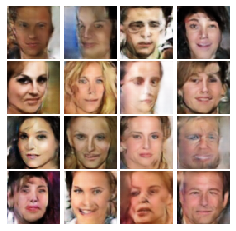


Iter: 11550, D: 0.04633, G:2.378


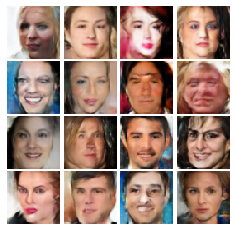


EPOCH:  48
Iter: 11700, D: 0.1709, G:1.307


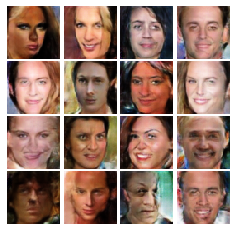


EPOCH:  49
Iter: 11850, D: 0.1307, G:4.202


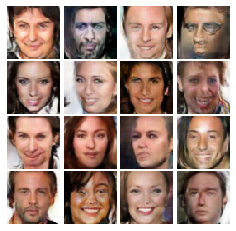


Iter: 12000, D: 2.843, G:5.854


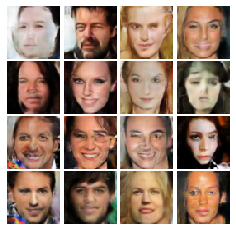


EPOCH:  50
Iter: 12150, D: 0.2057, G:2.467


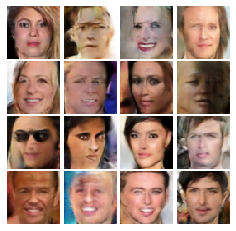

In [13]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=150,
          train_loader=celeba_loader_train, device=device)

### Train LS-GAN

In [14]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [15]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.6095, G:1.161


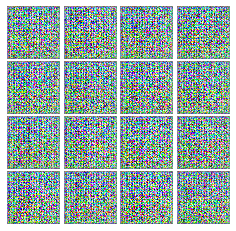


Iter: 200, D: 0.1215, G:0.405


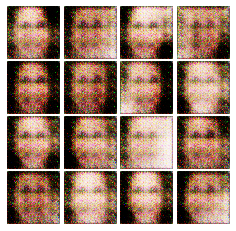


EPOCH:  2
Iter: 400, D: 0.1083, G:0.442


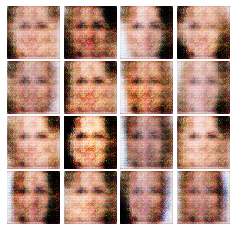


EPOCH:  3
Iter: 600, D: 0.1214, G:0.4651


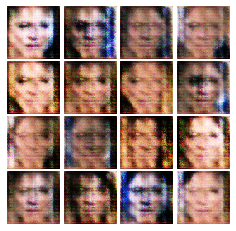


EPOCH:  4
Iter: 800, D: 0.06705, G:0.525


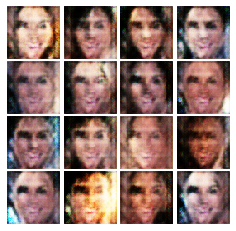


EPOCH:  5
Iter: 1000, D: 0.07363, G:0.3824


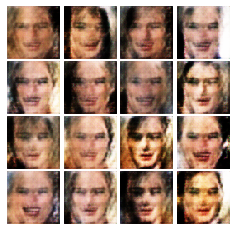


Iter: 1200, D: 0.08114, G:0.4708


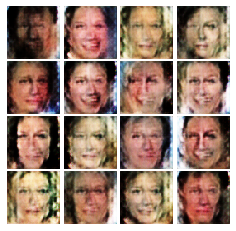


EPOCH:  6
Iter: 1400, D: 0.06372, G:0.4109


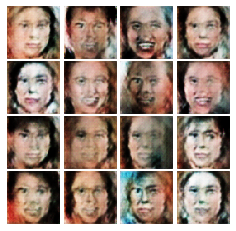


EPOCH:  7
Iter: 1600, D: 0.0951, G:0.6412


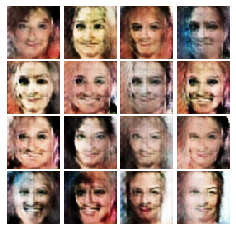


EPOCH:  8
Iter: 1800, D: 0.08539, G:0.3575


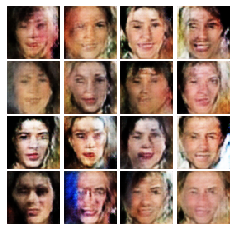


EPOCH:  9
Iter: 2000, D: 0.06656, G:0.4313


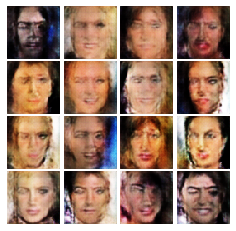


Iter: 2200, D: 0.0851, G:0.498


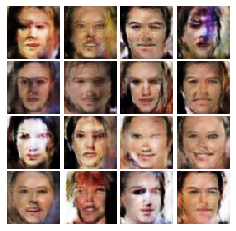


EPOCH:  10
Iter: 2400, D: 0.07529, G:0.3276


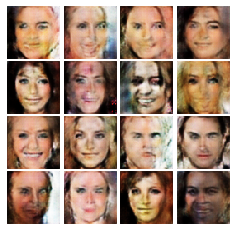


EPOCH:  11
Iter: 2600, D: 0.05067, G:0.473


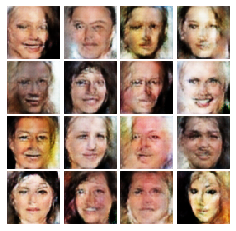


EPOCH:  12
Iter: 2800, D: 0.02795, G:0.4117


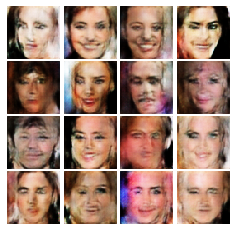


EPOCH:  13
Iter: 3000, D: 0.2759, G:0.9901


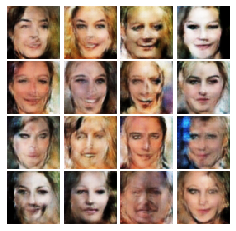


EPOCH:  14
Iter: 3200, D: 0.01622, G:0.3237


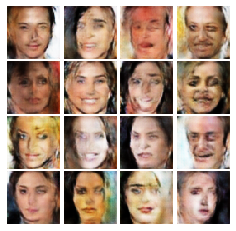


Iter: 3400, D: 0.189, G:0.3465


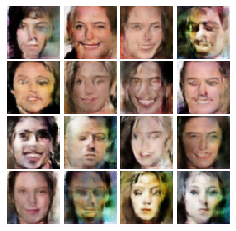


EPOCH:  15
Iter: 3600, D: 0.01886, G:0.6822


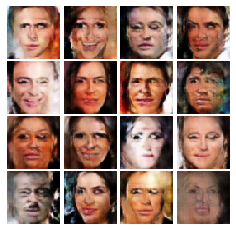


EPOCH:  16
Iter: 3800, D: 0.05225, G:0.3096


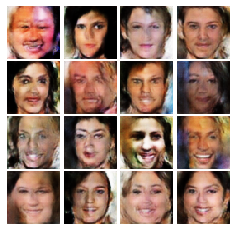


EPOCH:  17
Iter: 4000, D: 0.03847, G:0.5974


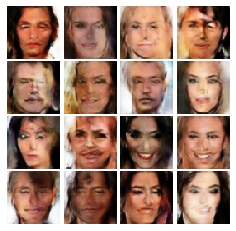


EPOCH:  18
Iter: 4200, D: 0.08758, G:0.3673


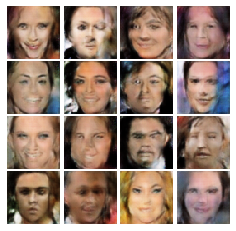


Iter: 4400, D: 0.05237, G:0.2301


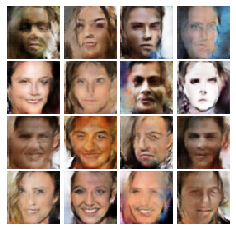


EPOCH:  19
Iter: 4600, D: 0.08217, G:0.308


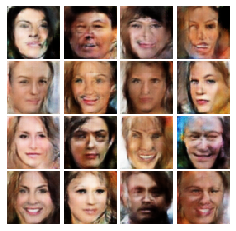


EPOCH:  20
Iter: 4800, D: 0.02693, G:0.3038


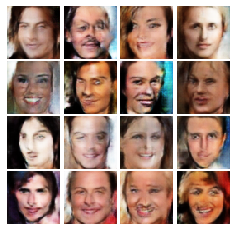


EPOCH:  21
Iter: 5000, D: 0.03741, G:0.4089


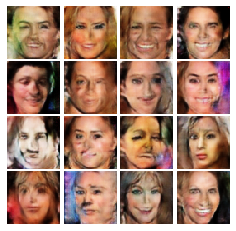


EPOCH:  22
Iter: 5200, D: 0.1609, G:0.1596


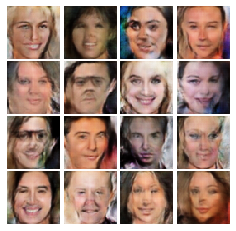


Iter: 5400, D: 0.02076, G:0.5099


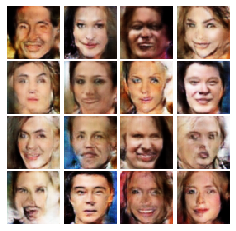


EPOCH:  23
Iter: 5600, D: 0.05308, G:0.5443


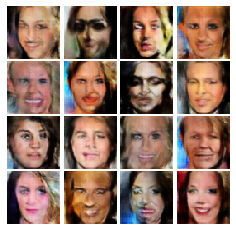


EPOCH:  24
Iter: 5800, D: 0.03532, G:0.8248


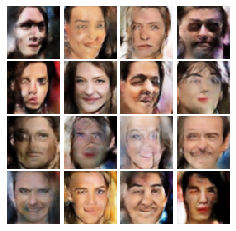


EPOCH:  25
Iter: 6000, D: 0.03607, G:0.3871


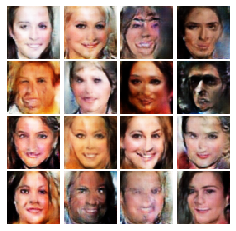


EPOCH:  26
Iter: 6200, D: 0.01737, G:0.3239


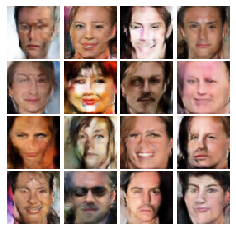


EPOCH:  27
Iter: 6400, D: 0.01011, G:0.4319


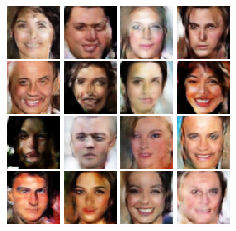


Iter: 6600, D: 0.1166, G:0.233


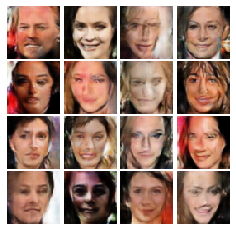


EPOCH:  28
Iter: 6800, D: 0.02805, G:0.3149


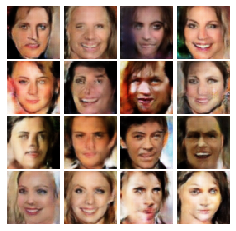


EPOCH:  29
Iter: 7000, D: 0.1342, G:0.3492


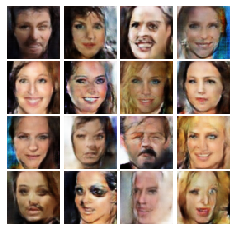


EPOCH:  30
Iter: 7200, D: 0.06568, G:0.8489


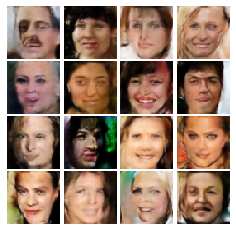


EPOCH:  31
Iter: 7400, D: 0.05563, G:0.3672


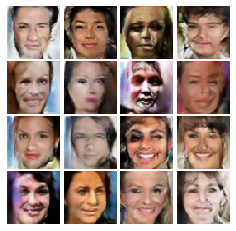


Iter: 7600, D: 0.1002, G:0.5173


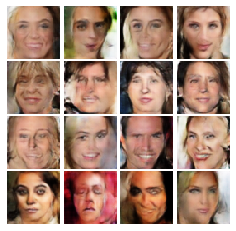


EPOCH:  32
Iter: 7800, D: 0.08873, G:0.4007


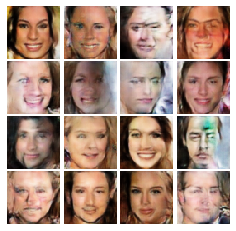


EPOCH:  33
Iter: 8000, D: 0.01534, G:0.6955


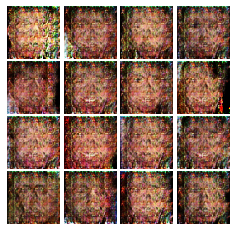


EPOCH:  34
Iter: 8200, D: 0.01872, G:0.4948


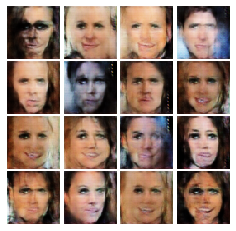


EPOCH:  35
Iter: 8400, D: 0.07241, G:0.1997


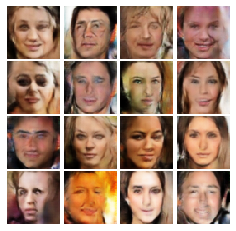


Iter: 8600, D: 0.2666, G:0.3748


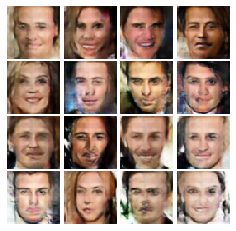


EPOCH:  36
Iter: 8800, D: 0.07717, G:0.3367


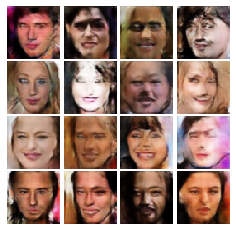


EPOCH:  37
Iter: 9000, D: 0.1299, G:0.4132


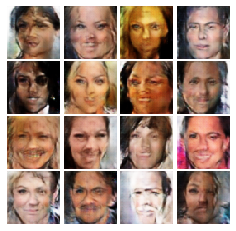


EPOCH:  38
Iter: 9200, D: 0.04381, G:0.2923


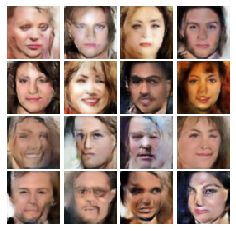


EPOCH:  39
Iter: 9400, D: 0.1184, G:0.5962


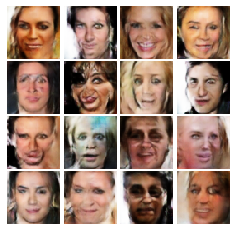


EPOCH:  40
Iter: 9600, D: 0.1215, G:0.2583


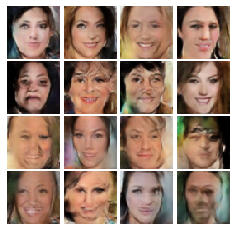


Iter: 9800, D: 0.03494, G:0.5641


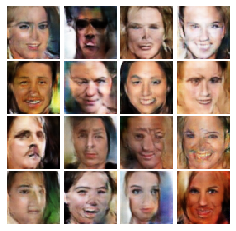


EPOCH:  41
Iter: 10000, D: 0.04969, G:0.3405


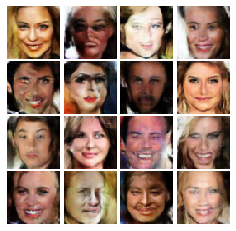


EPOCH:  42
Iter: 10200, D: 0.0587, G:0.4622


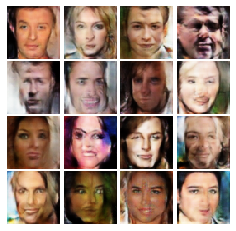


EPOCH:  43
Iter: 10400, D: 0.1104, G:0.3289


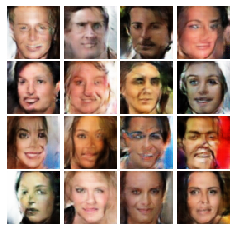


EPOCH:  44
Iter: 10600, D: 0.01882, G:0.4758


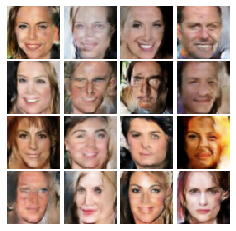


Iter: 10800, D: 0.183, G:0.3861


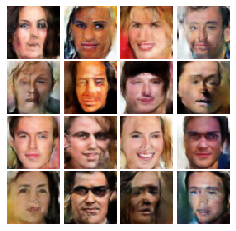


EPOCH:  45
Iter: 11000, D: 0.1431, G:1.189


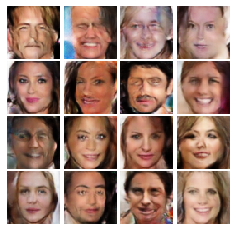


EPOCH:  46
Iter: 11200, D: 0.1868, G:0.2054


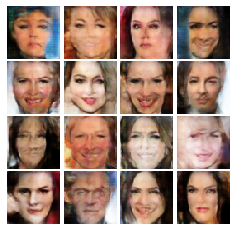


EPOCH:  47
Iter: 11400, D: 0.1745, G:0.4863


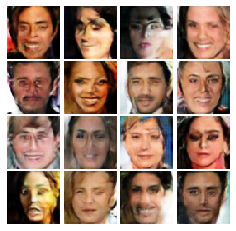


EPOCH:  48
Iter: 11600, D: 0.06665, G:0.4898


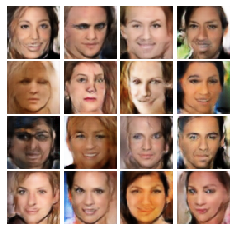


Iter: 11800, D: 0.02341, G:0.6495


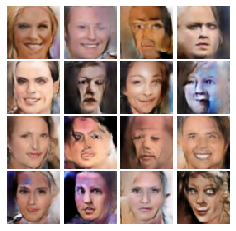


EPOCH:  49
Iter: 12000, D: 0.03548, G:0.68


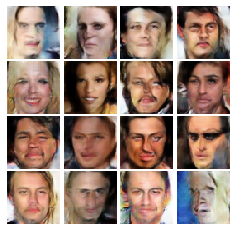


EPOCH:  50
Iter: 12200, D: 0.1093, G:0.3839


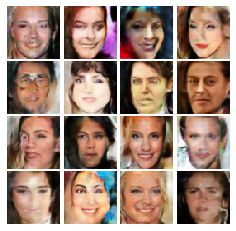

In [16]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=200,
          train_loader=celeba_loader_train, device=device)